In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.pyplot import figure
import numpy as np
from vega import VegaLite

In [2]:
sorties_mixtes = pd.read_csv("sorties_navires_vers_etranger_mixte_DFLR_ailleurs_tout1787.csv")

### "multi-Etat":

In [3]:
sorties_mixtes[sorties_mixtes.state_destination == "multi-Etat"].port_destination.value_counts()

Italie                         107
Côte d'Or                       36
Côte d'Afrique [de l'Ouest]     22
Indes orientales                 3
îles sous le Vent                1
Gambie                           1
Côtes de Barbarie                1
Côte de Coromandel               1
Name: port_destination, dtype: int64

In [4]:
sorties_mixtes = sorties_mixtes[sorties_mixtes.state_destination != "zone maritime"]
sorties_mixtes = sorties_mixtes.replace("Havre", "Le Havre")

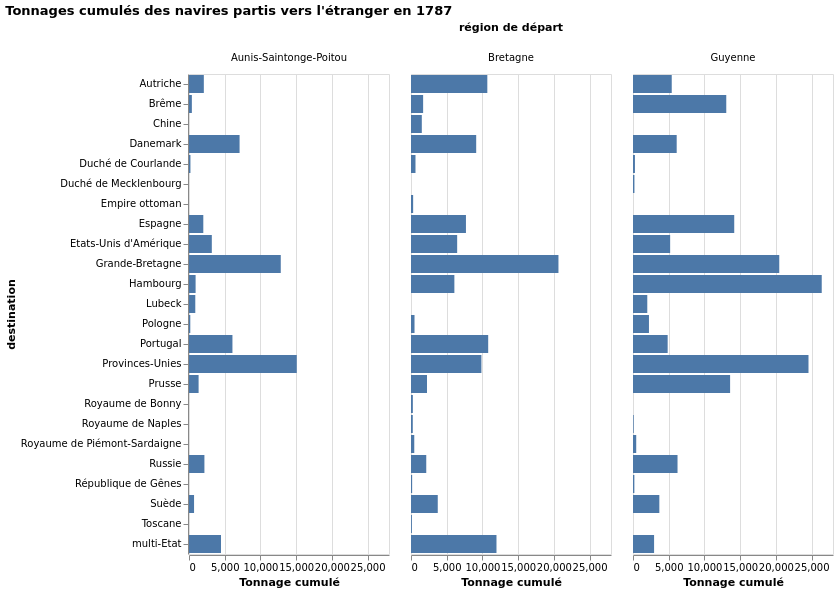

In [5]:
VegaLite({
  "title": "Tonnages cumulés des navires partis vers l'étranger en 1787",
  "facet": {"column": {"field": "region_depart", "title": "région de départ"}},
  "spec": {
    "mark": "bar",
    "encoding": {
      "y": {
        "field": "state_destination",
        "title": "destination",
        "type": "nominal"
      },
      "x": {
          "aggregate": "sum", 
          "type": "quantitative", 
          "field": "tonnage",
          "title": "Tonnage cumulé",
      }
        
    }
  }
}, sorties_mixtes[sorties_mixtes.region_depart.isin(["Aunis-Saintonge-Poitou", "Bretagne", "Guyenne"])]
)

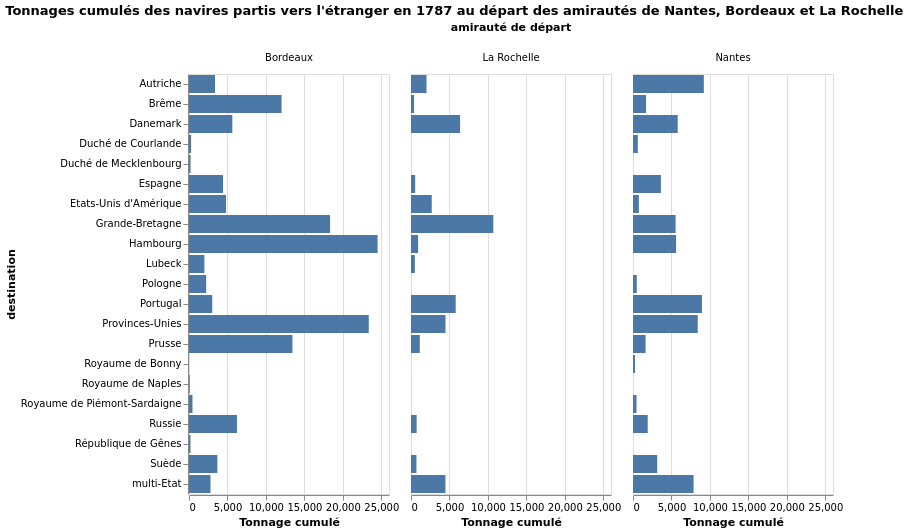

In [6]:
VegaLite({
  "facet": {"column": {"field": "amiraute_depart", "title": "amirauté de départ"}},
  "title": "Tonnages cumulés des navires partis vers l'étranger en 1787 au départ des amirautés de Nantes, Bordeaux et La Rochelle",
  "spec": {
    "mark": "bar",
    "encoding": {
      "y": {
        "field": "state_destination",
        "title": "destination",
        "type": "nominal"
      },
      "x": {
          "aggregate": "sum", 
          "type": "quantitative", 
          "field": "tonnage",
          "title": "Tonnage cumulé"
      }
        
    }
  }
}, sorties_mixtes[sorties_mixtes.amiraute_depart.isin(["Nantes", "Bordeaux", "La Rochelle"])]
)

In [7]:
# refaire la même chose pour les colonies (1987 comparaison La Rochelle, Nantes, Bordeaux)

In [8]:
exclude = ["Provence", "Roussillon", "Languedoc", "Isles de Corse", "Canada", "Guyane", "Guadeloupe"]

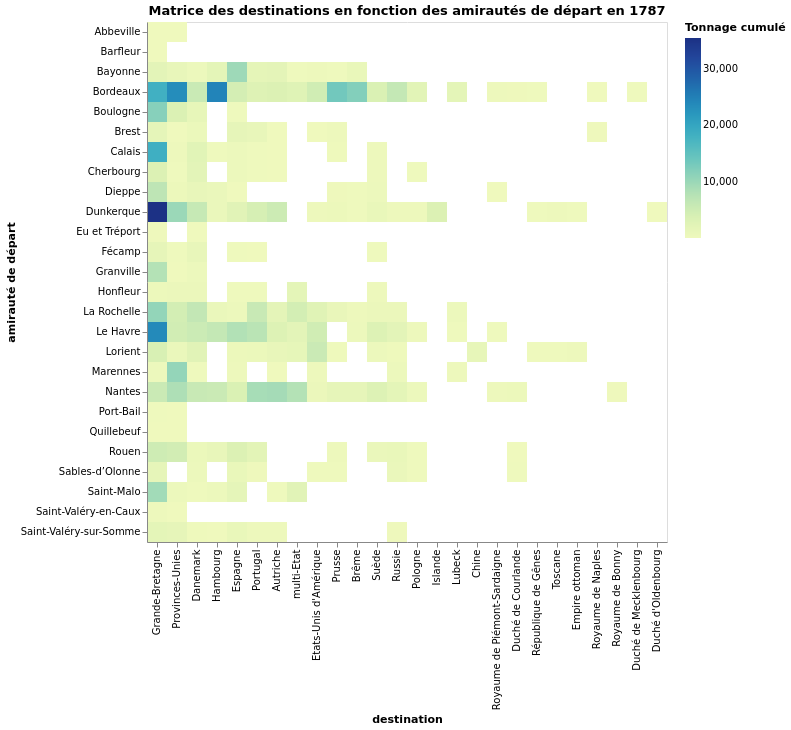

In [9]:
VegaLite({
    "title": "Matrice des destinations en fonction des amirautés de départ en 1787",
    "mark": "rect",
    "encoding": {
        "x": {
            "type": "nominal", 
            "field": "state_destination",
            "title": "destination",
            "sort": "-color"
        },
        "y": {
            "field": "amiraute_depart",
            "type": "nominal",
            "title": "amirauté de départ",
            "sort": "y"
        },
        "color": {
            "type": "quantitative",
            "aggregate": "sum",
            "field": "tonnage",
            "title": "Tonnage cumulé"
        }
    }
}, sorties_mixtes[~sorties_mixtes.region_depart.isin(exclude)])

In [10]:
sorties_mixtes["tonnage_total_amirauté"] = sorties_mixtes.amiraute_depart.map(
    sorties_mixtes.groupby("amiraute_depart").tonnage.sum()
)

In [11]:
sorties_mixtes["share_on_amiraute"] = sorties_mixtes["tonnage"]*100 / sorties_mixtes["tonnage_total_amirauté"]

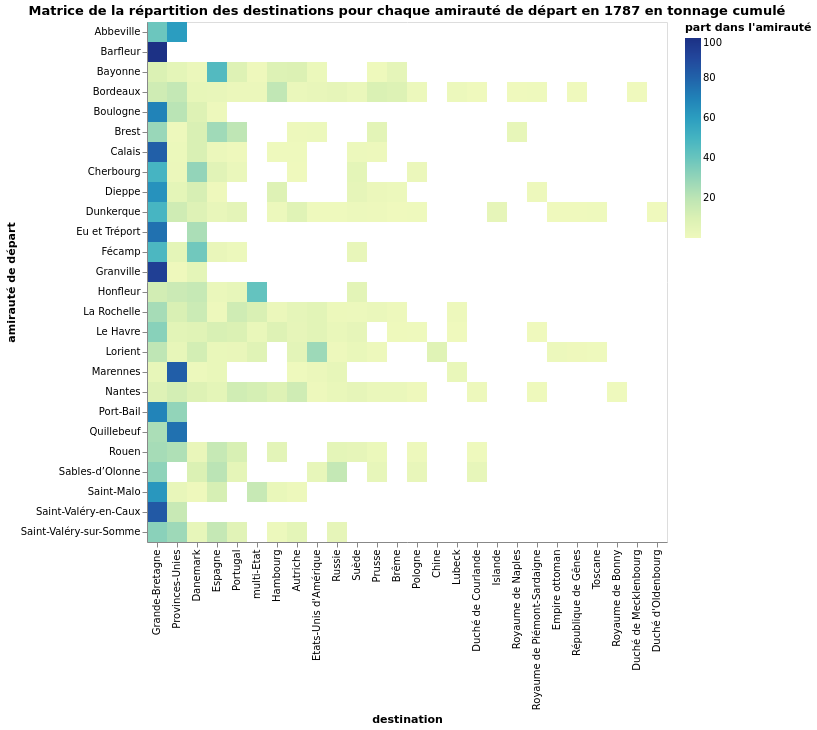

In [12]:
VegaLite({
    "title": "Matrice de la répartition des destinations pour chaque amirauté de départ en 1787 en tonnage cumulé",
    "mark": "rect",
    "encoding": {
        "x": {
            "type": "nominal", 
            "field": "state_destination",
            "title": "destination",
            "sort": "-color"
        },
        "y": {
            "field": "amiraute_depart",
            "type": "nominal",
            "title": "amirauté de départ",
            "sort": "y"
        },
        "color": {
            "type": "quantitative",
            "aggregate": "sum",
            "field": "share_on_amiraute",
            "title": "part dans l'amirauté"
        }
    }
}, sorties_mixtes[~sorties_mixtes.region_depart.isin(exclude)])